In [16]:
from time import time
s = time()

import os

import matplotlib
import matplotlib.pyplot as plt

# import io
# import scipy.misc
import numpy as np
from six import BytesIO
from PIL import Image#, ImageDraw, ImageFont

import tensorflow as tf

%matplotlib inline

from object_detection.utils import label_map_util
from object_detection.utils import config_util
from object_detection.utils import visualization_utils as viz_utils
from object_detection.builders import model_builder

print(time()-s)

0.003989696502685547


In [12]:
s = time()
def load_image_into_numpy_array(path):
    img_data = tf.io.gfile.GFile(path, 'rb').read()
    image = Image.open(BytesIO(img_data))
    (im_width, im_height) = image.size
    return np.array(image.getdata()).reshape(
        (im_height, im_width, 3)).astype(np.uint8)

def get_keypoint_tuples(eval_config):
    tuple_list = []
    kp_list = eval_config.keypoint_edge
    for edge in kp_list:
        tuple_list.append((edge.start, edge.end))
    return tuple_list

def load_label_map():
    label_map_path = 'object_detection/data/mscoco_label_map.pbtxt'
    label_map = label_map_util.load_labelmap(label_map_path)
    categories = label_map_util.convert_label_map_to_categories(
                                                                label_map,
                                                                max_num_classes=label_map_util.get_max_label_map_index(label_map),
                                                                use_display_name=True)
    category_index = label_map_util.create_category_index(categories)
    label_map_dict = label_map_util.get_label_map_dict(label_map, use_display_name=True)

    return category_index, label_map_dict

def load_model():
    model_name = 'centernet_resnet101_v1_fpn_512x512_coco17_tpu-8'
    pipeline_config = os.path.join(os.getcwd(), 'object_detection', 'test_data', model_name, 'pipeline.config')
    model_dir = os.path.join(os.getcwd(), 'object_detection', 'test_data', model_name, 'checkpoint')

    # Load pipeline config and build a detection model
    configs = config_util.get_configs_from_pipeline_file(pipeline_config)
    model_config = configs['model']
    # model_config.center_net.object_center_params.max_box_predictions = 200

    detection_model = model_builder.build(model_config=model_config, is_training=False)

    # Restore checkpoint
    ckpt = tf.compat.v2.train.Checkpoint(model=detection_model)
    ckpt.restore(os.path.join(model_dir, 'ckpt-0')).expect_partial()
    return detection_model, configs

def get_model_detection_function(model):
    """Get a tf.function for detection."""

    @tf.function
    def detect_fn(image):
        """Detect objects in image."""

        image, shapes = model.preprocess(image)
        prediction_dict = model.predict(image, shapes)
        detections = model.postprocess(prediction_dict, shapes)

        return detections, prediction_dict, tf.reshape(shapes, [-1])

    return detect_fn

detection_model, configs = load_model()
detect_fn = get_model_detection_function(detection_model)

print(time()-s)

17.640849590301514


In [13]:
os.listdir('data/images')

['p202008081844', 'p202008082112']

In [14]:
data_dir = os.path.join(os.getcwd(), 'data', 'images', 'p202008082112')
category_index, label_map_dict = load_label_map()

87 images to process
1001_2108_20200808211240_8fafdb.jpg
Instructions for updating:
Use `tf.cast` instead.


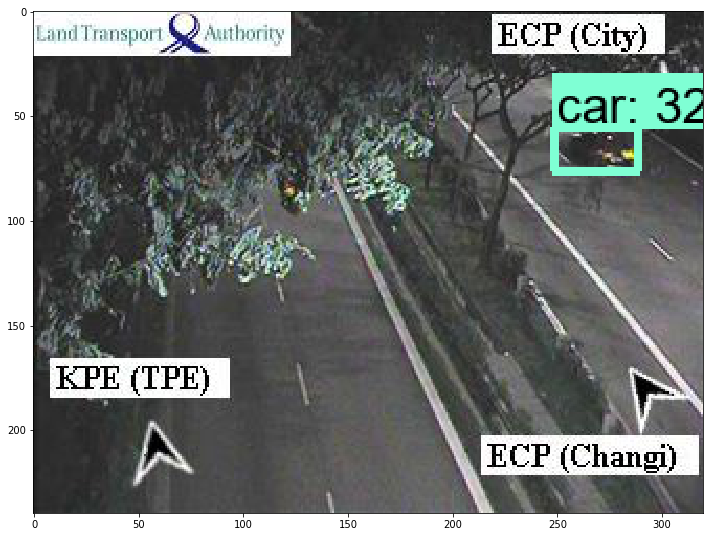

8.37459921836853

1002_2108_20200808211240_685773.jpg


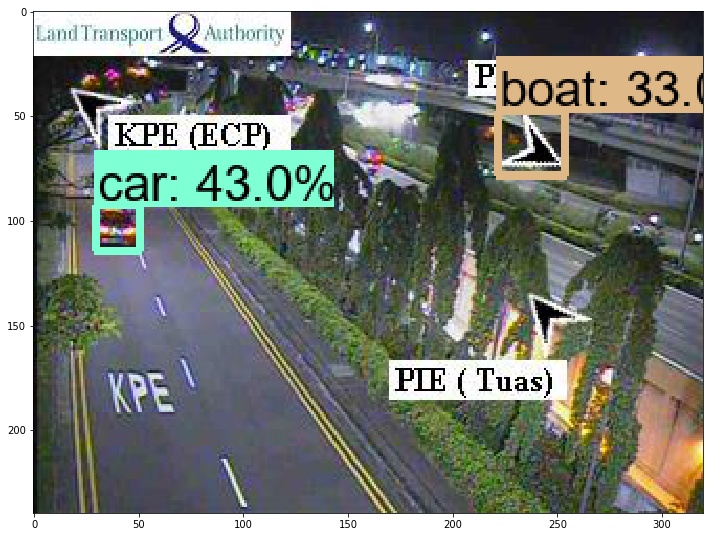

1.19679856300354

1003_2108_20200808211240_25aaf8.jpg


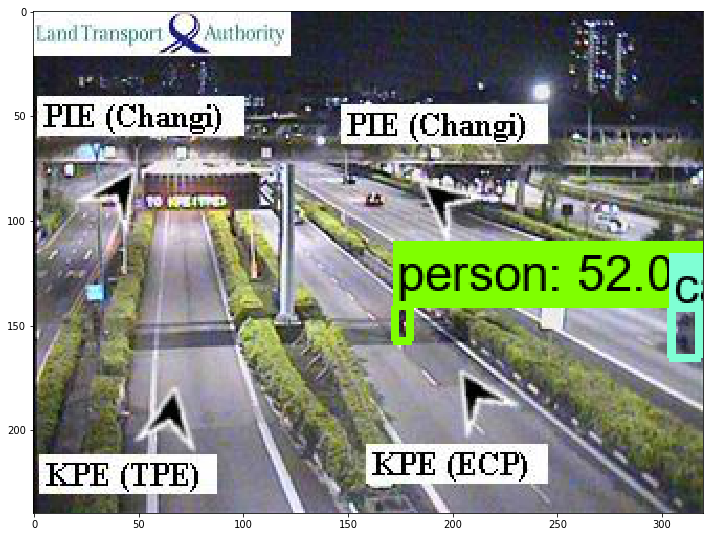

1.184866189956665

1004_2108_20200808211240_df150c.jpg


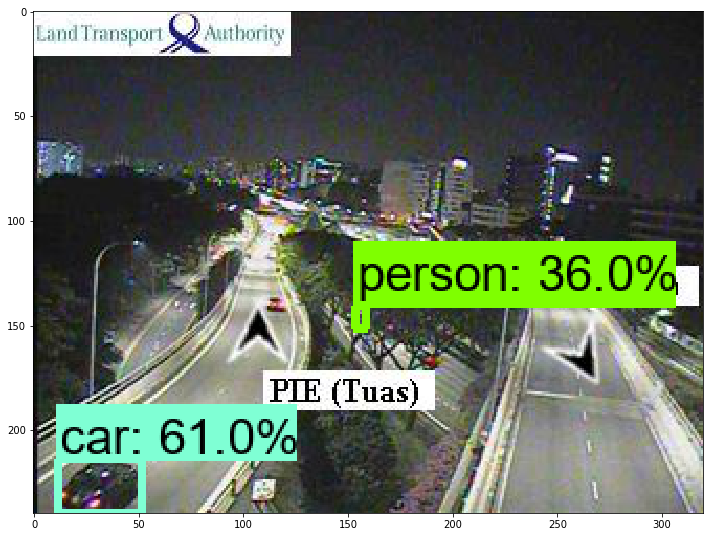

1.1857924461364746

1005_2108_20200808211240_f8d8e8.jpg


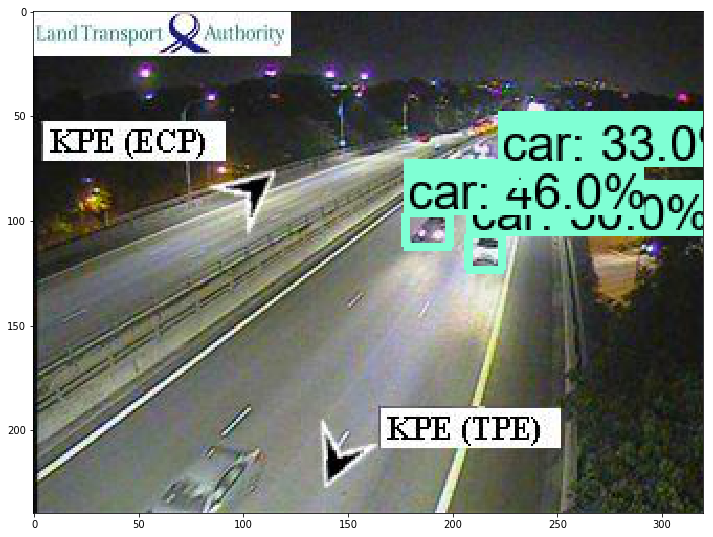

1.3324370384216309

1006_2108_20200808211239_ce106e.jpg


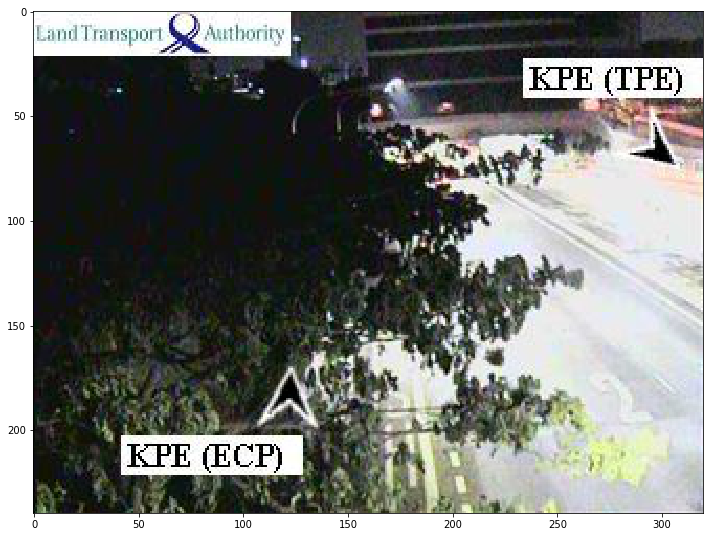

1.187854528427124

1501_2108_20200808211240_a55474.jpg


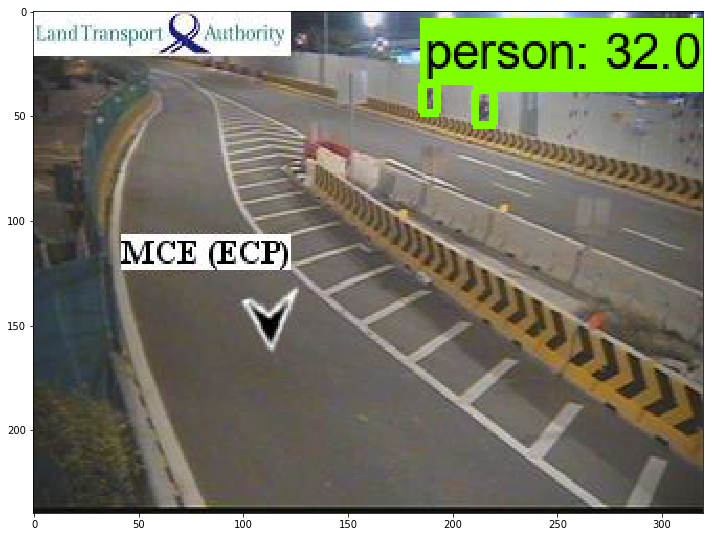

1.203747034072876

1502_2108_20200808211240_2b420f.jpg


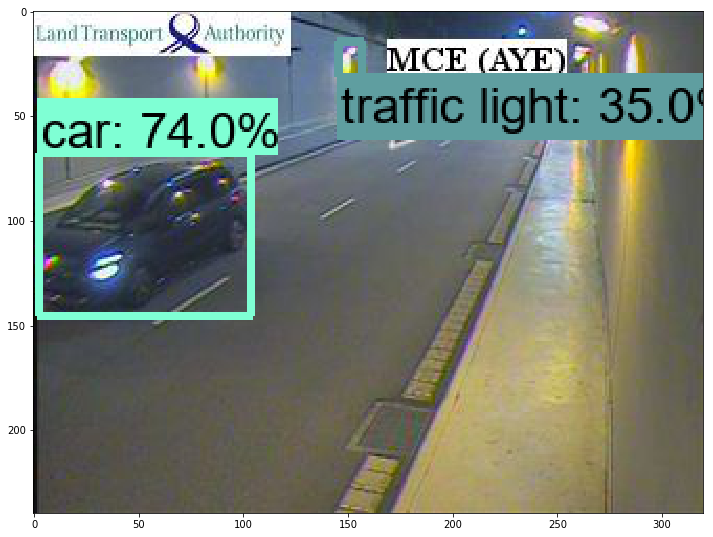

1.1758544445037842

1503_2108_20200808211240_a334cd.jpg


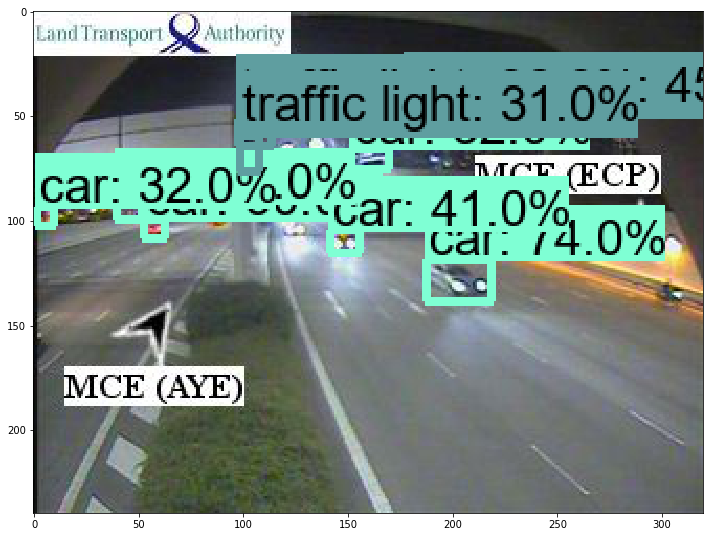

1.2456684112548828

1504_2108_20200808211240_4cd41f.jpg


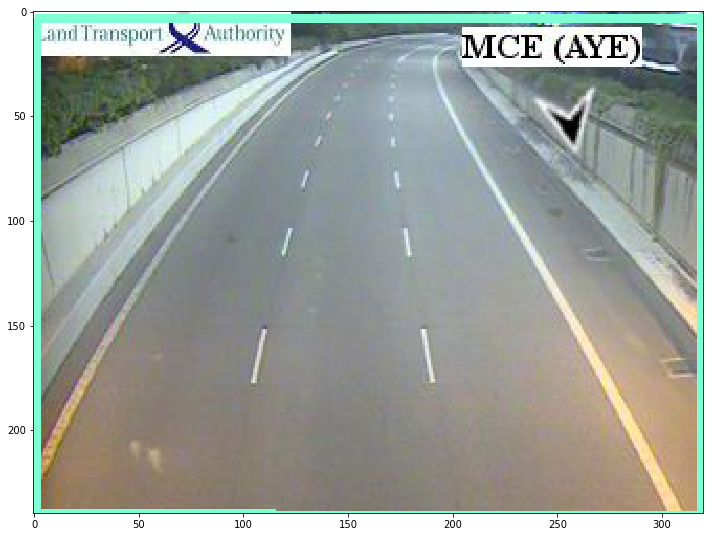

1.1808419227600098

1505_2108_20200808211240_5353ca.jpg


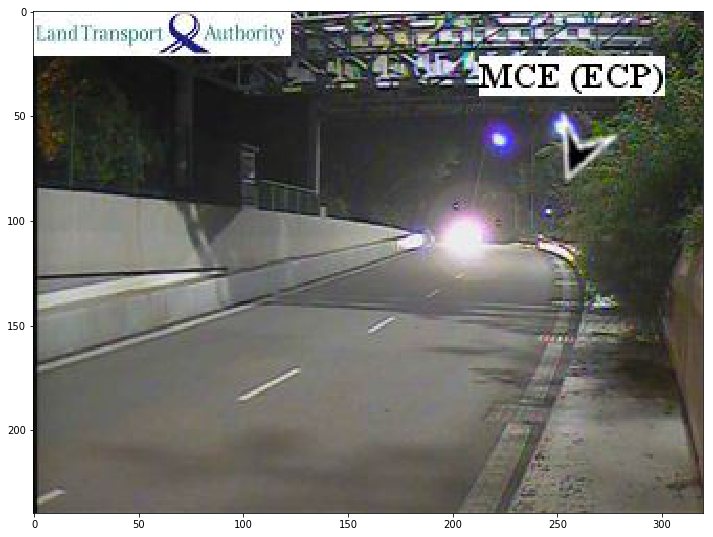

1.1848297119140625

1701_2109_20200808211228_57b9f8.jpg


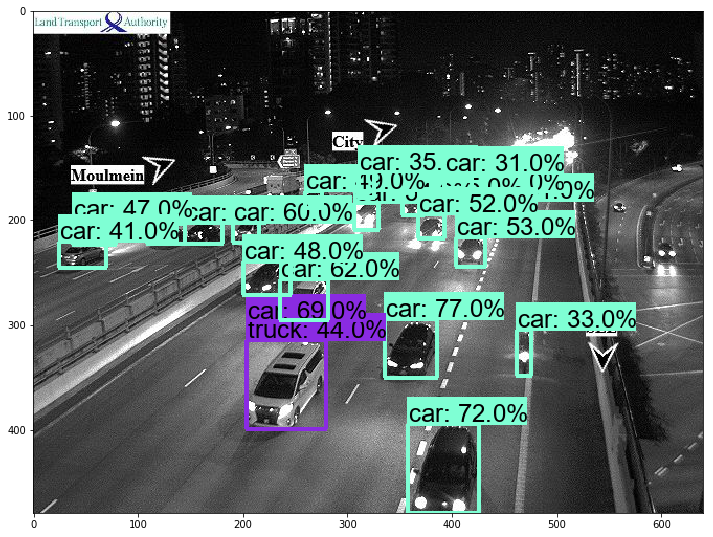

3.498640775680542

1702_2109_20200808211227_d45b0c.jpg


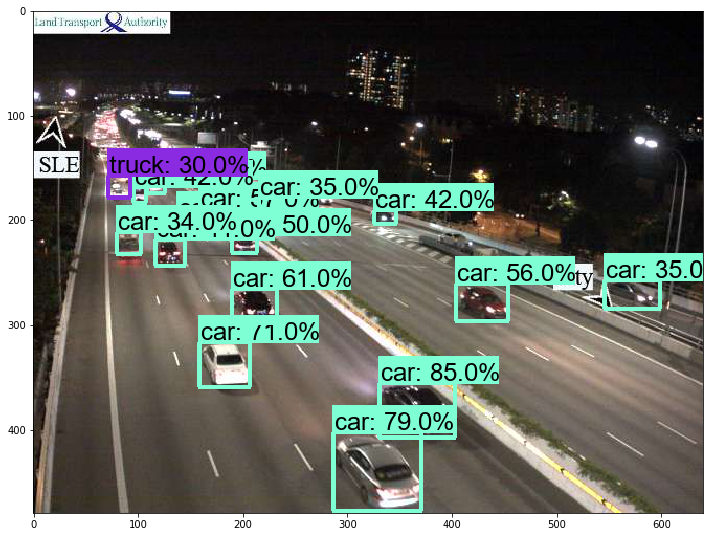

1.5977263450622559

1703_2110_20200808211227_e12ed8.jpg


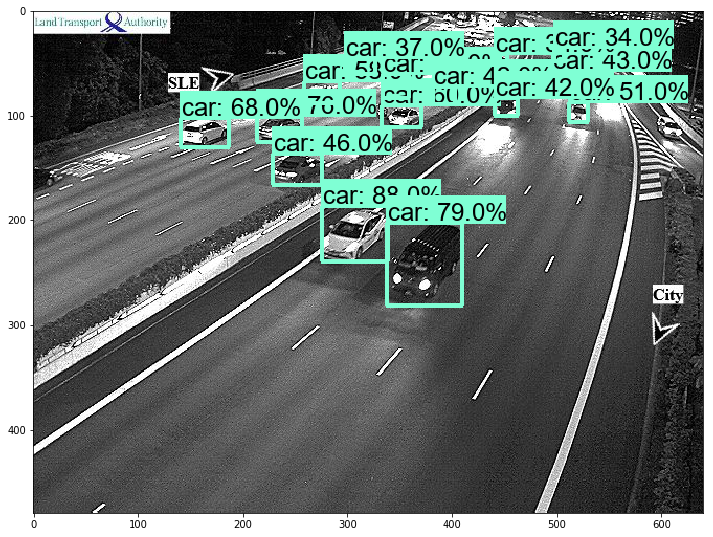

1.5857582092285156

1704_2110_20200808211226_0afeb9.jpg


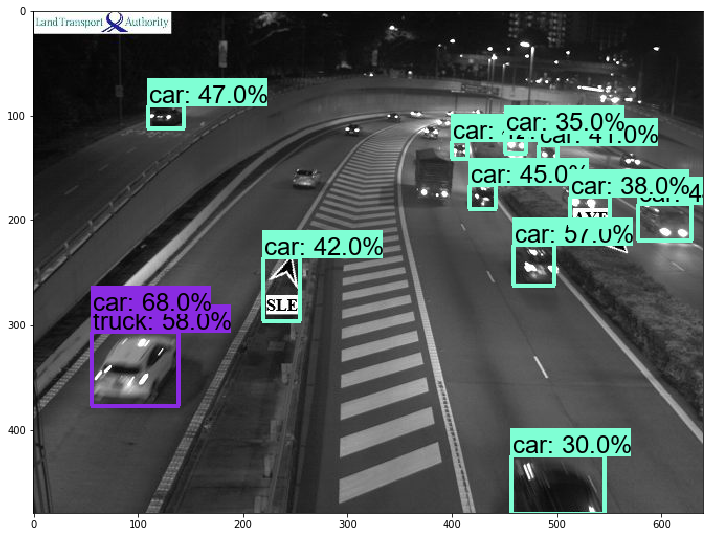

1.6017279624938965

1705_2109_20200808211226_5a0038.jpg


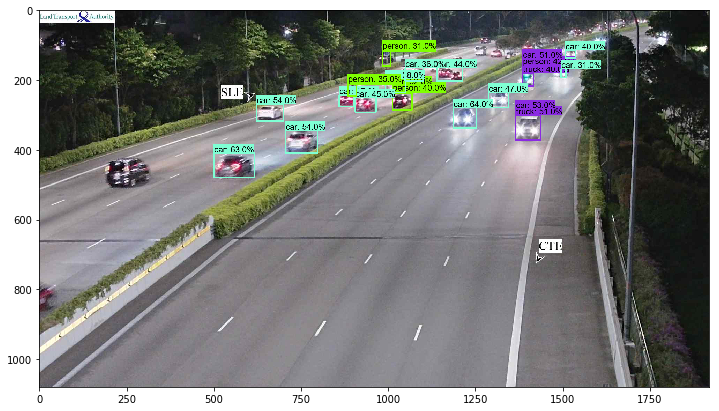

5.847358465194702

1706_2109_20200808211225_73c202.jpg


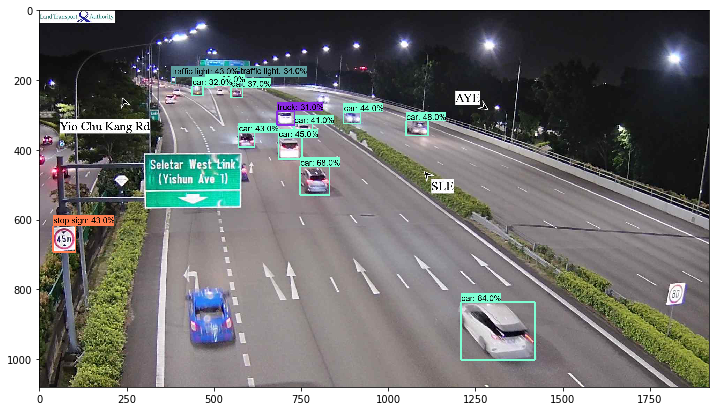

3.96639084815979

1707_2108_20200808211225_d54f10.jpg


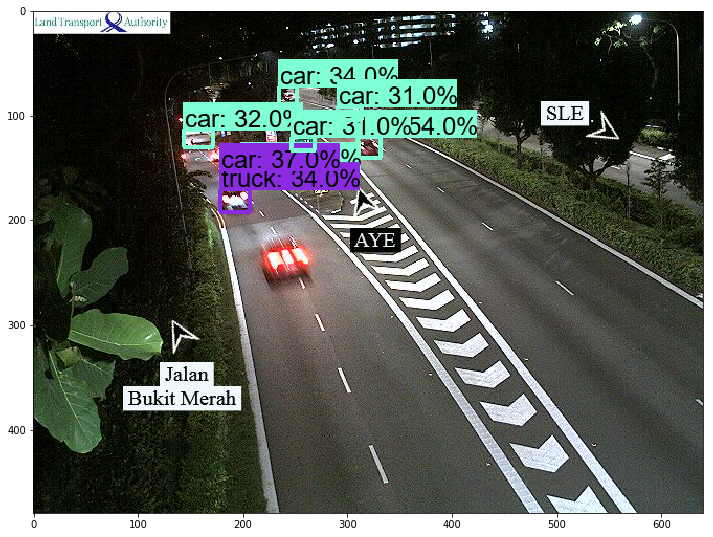

1.8111543655395508

1709_2110_20200808211224_83a0f4.jpg


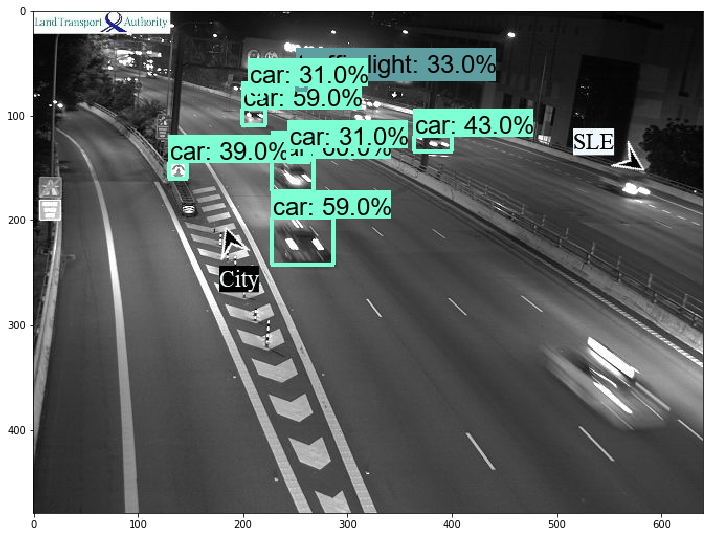

1.778244972229004

1711_2110_20200808211221_150bcf.jpg


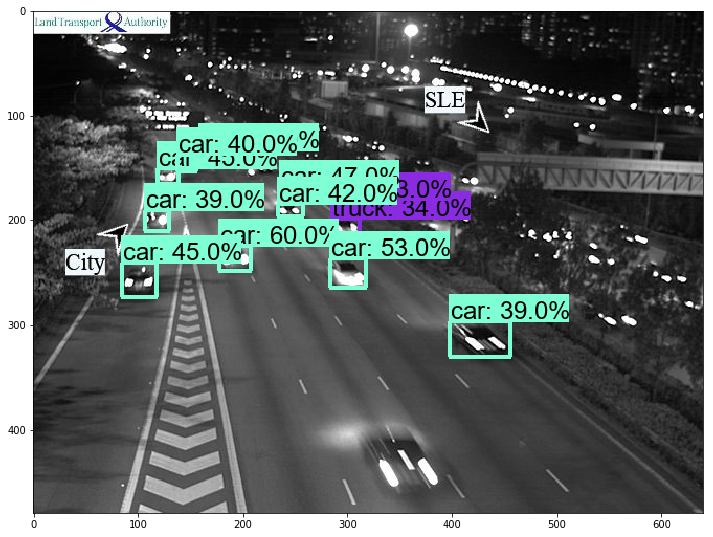

2.3048946857452393

2701_2110_20200808211230_e7bf11.jpg


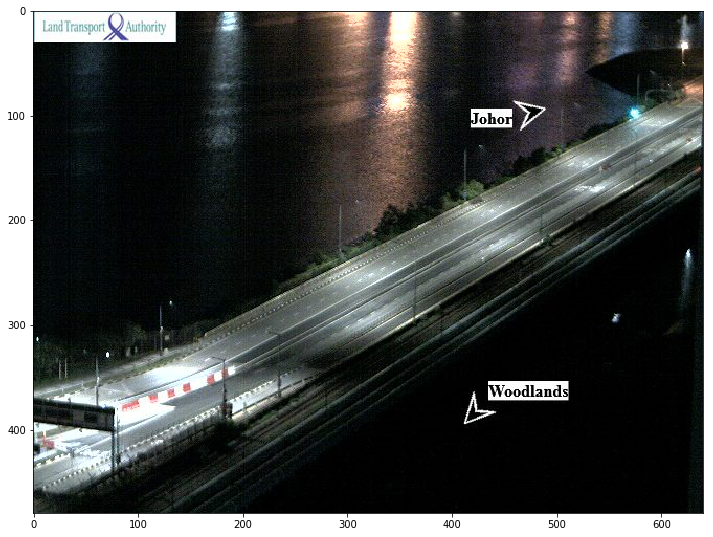

1.6635499000549316

2702_2109_20200808211229_c2da5c.jpg


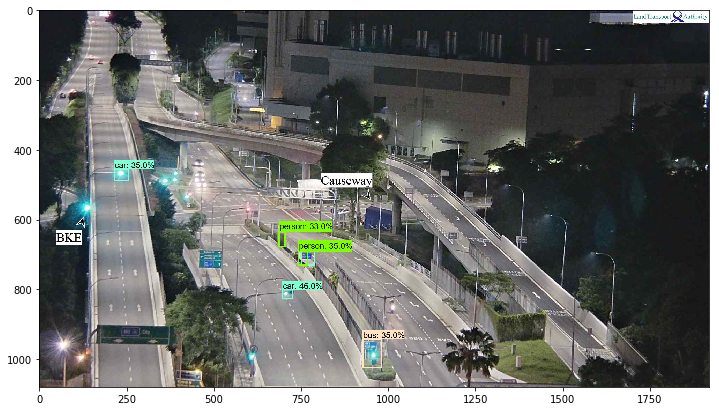

3.210975408554077

2703_2110_20200808211229_480341.jpg


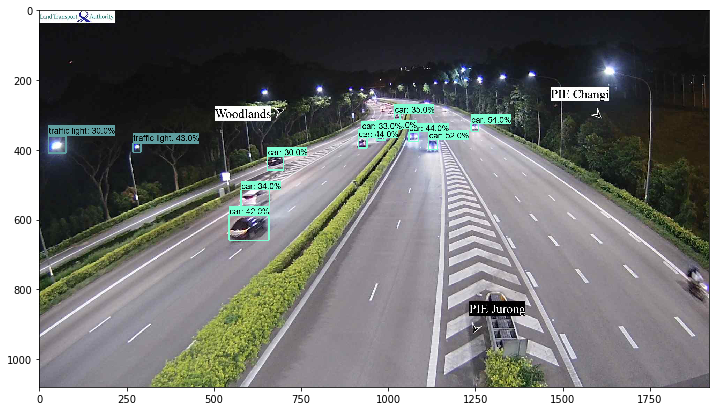

3.6311540603637695

2704_2109_20200808211229_624e0f.jpg


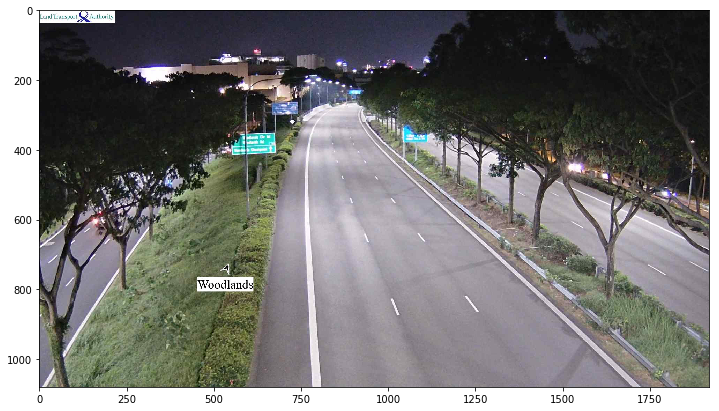

2.9990105628967285

2705_2110_20200808211228_80fb16.jpg


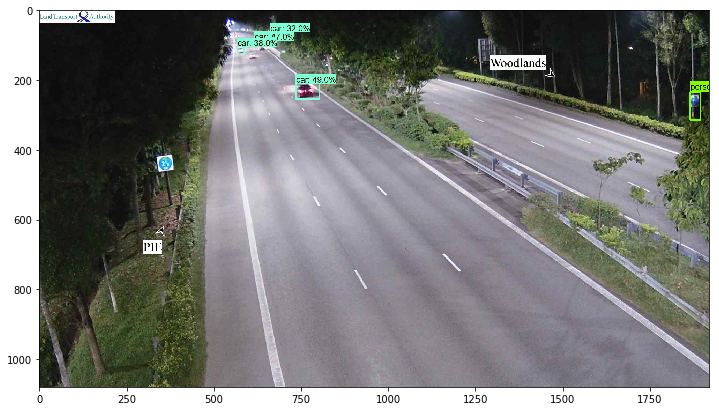

3.0777952671051025

2706_2109_20200808211228_9ab10f.jpg


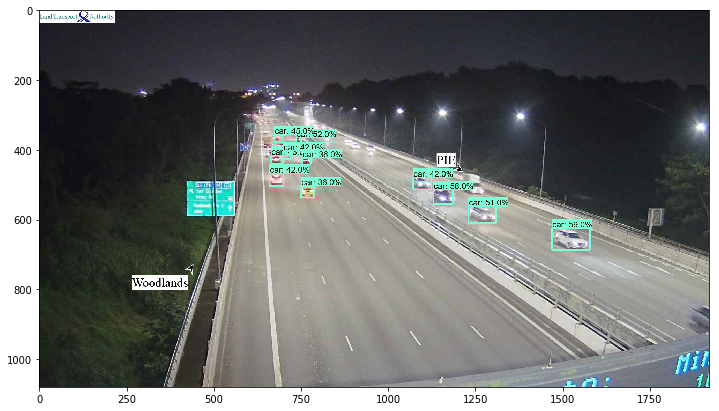

3.0069539546966553

2707_2110_20200808211227_48ee6f.jpg


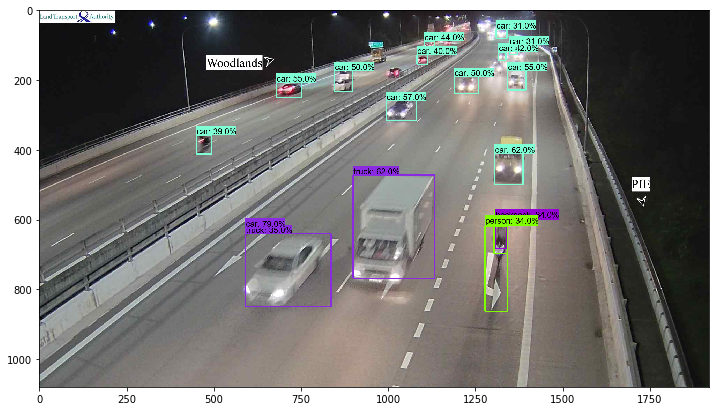

3.2193894386291504

2708_2109_20200808211226_f38fb7.jpg


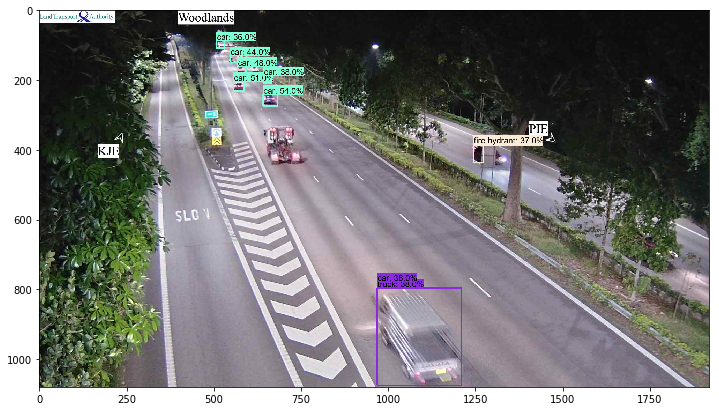

3.1934242248535156

3702_2109_20200808211232_c90dd9.jpg


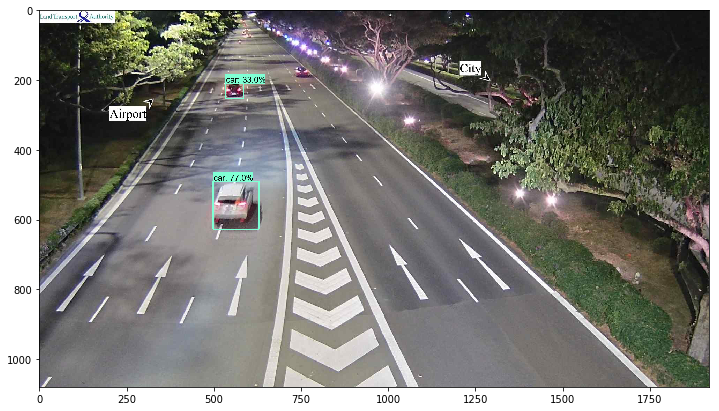

3.014324188232422

3704_2109_20200808211231_9fccd7.jpg


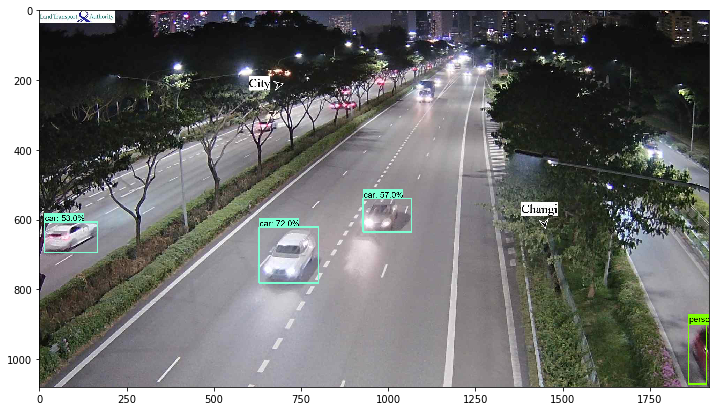

3.1157915592193604

3705_2110_20200808211230_21ee69.jpg


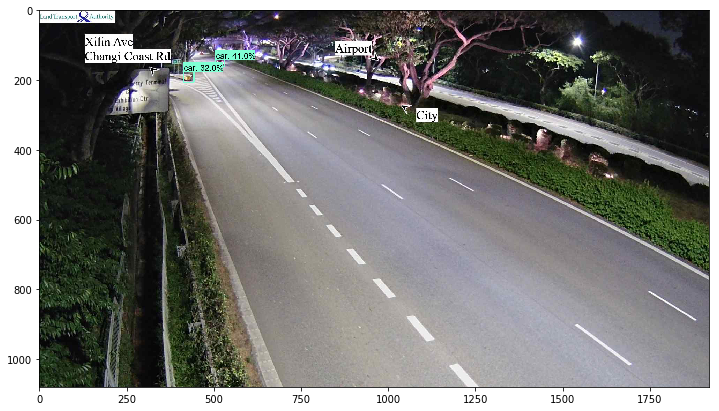

3.0179643630981445

3793_2109_20200808211211_83f1a7.jpg


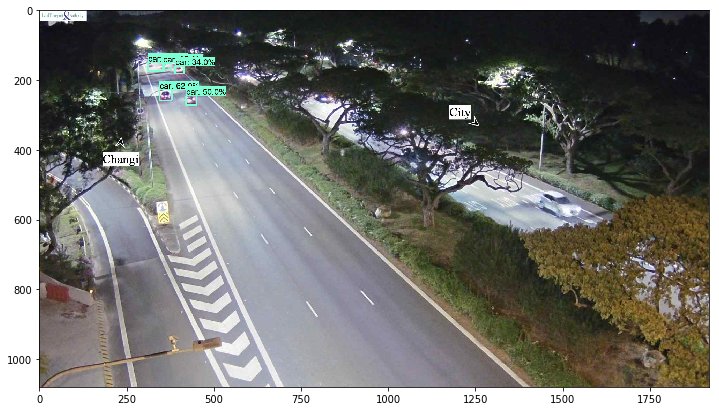

3.104696273803711

3795_2109_20200808211208_f6de56.jpg


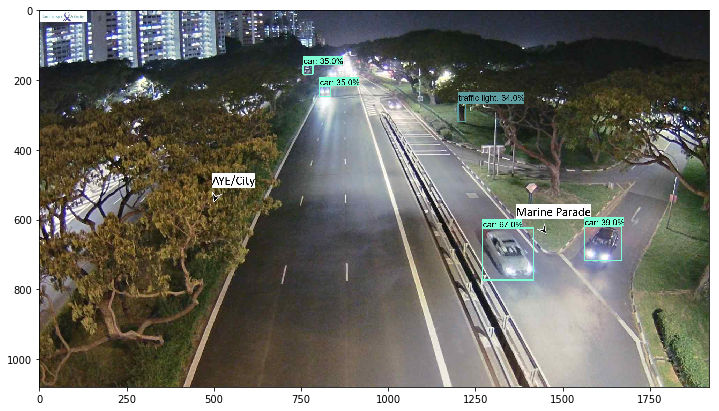

3.106721878051758

3796_2109_20200808211204_82534c.jpg


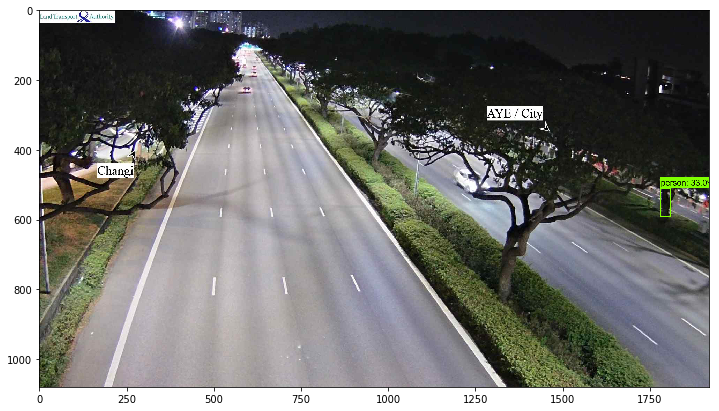

3.23933482170105

3797_2109_20200808211201_e8ba53.jpg


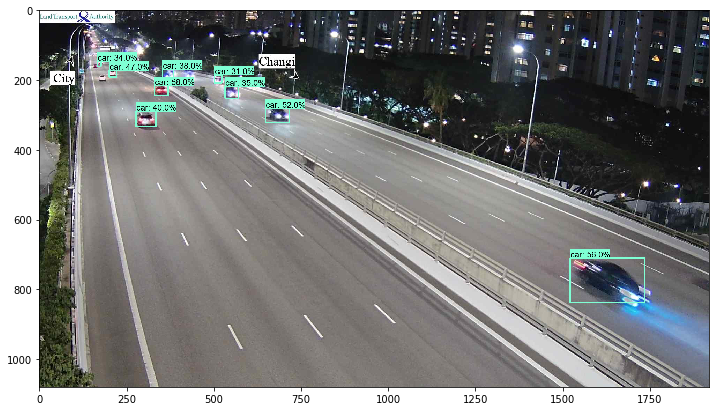

3.170485734939575

3798_2109_20200808211200_133745.jpg


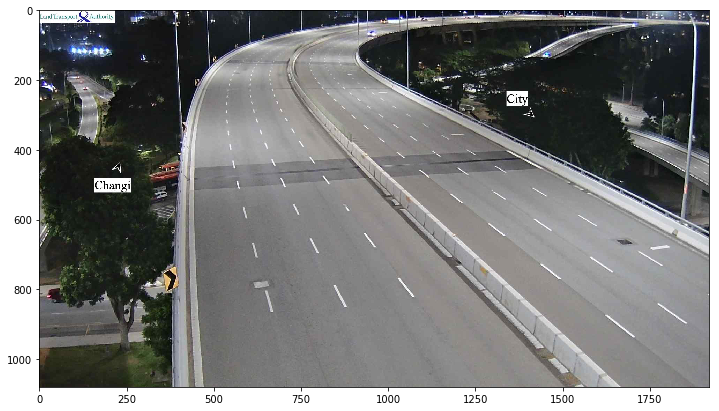

2.8035011291503906

4701_2109_20200808211235_15ab48.jpg


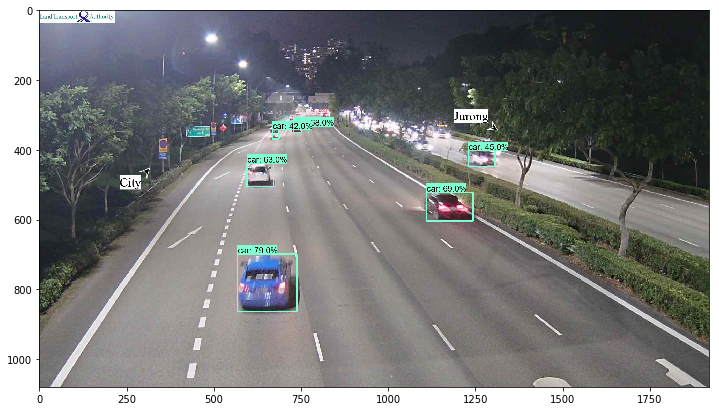

3.101702928543091

4702_2109_20200808211235_8f53d3.jpg


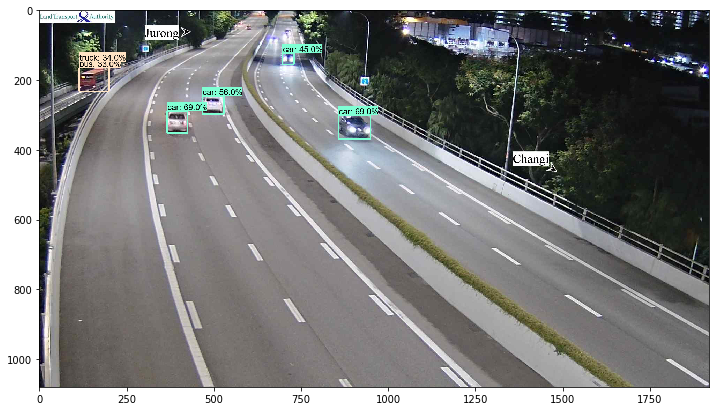

4.316455125808716

4703_2109_20200808211234_ae395d.jpg


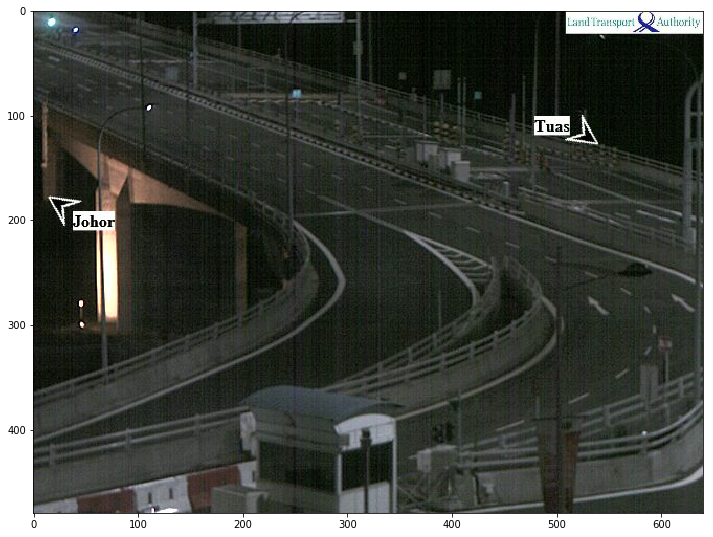

1.6805438995361328

4704_2109_20200808211234_bd658e.jpg


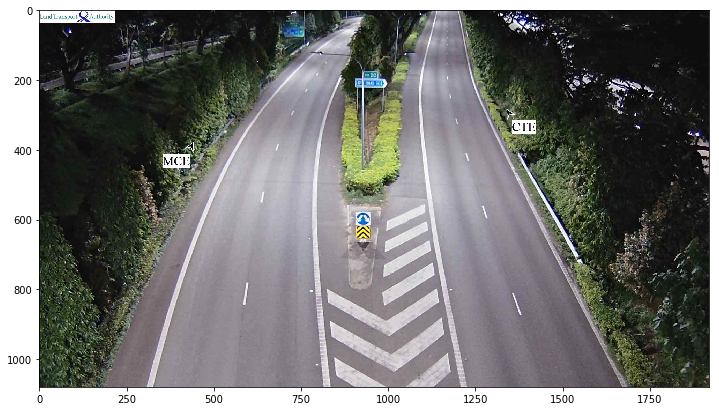

2.99103045463562

4705_2109_20200808211233_2cb5b7.jpg


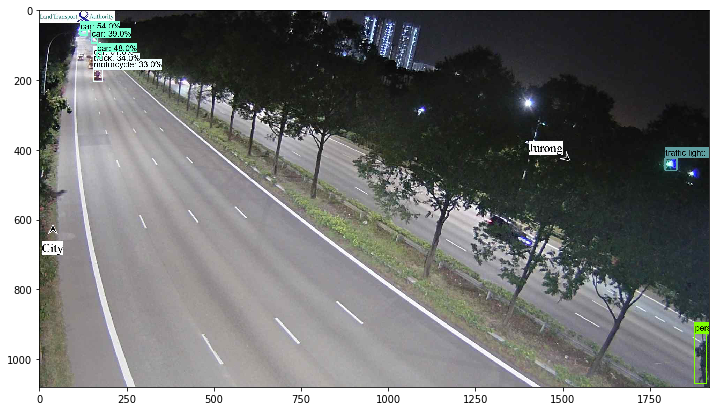

3.08272123336792

4706_2110_20200808211233_44b9e5.jpg


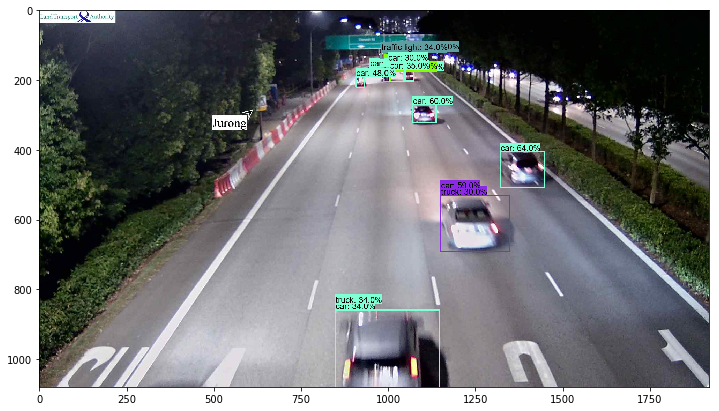

3.158585786819458

4707_2110_20200808211232_98b8c6.jpg


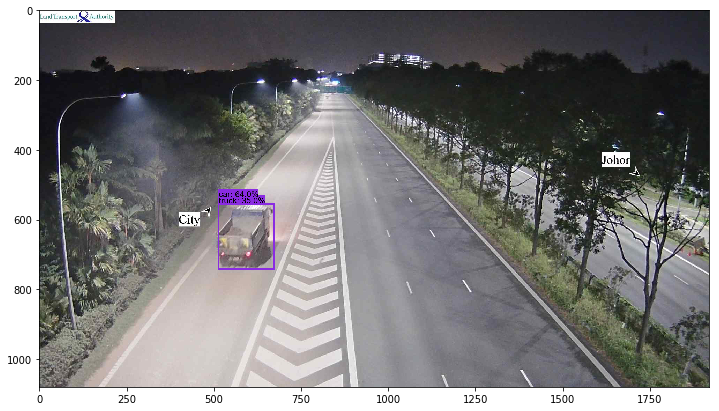

2.8822555541992188

4708_2110_20200808211232_2a175c.jpg


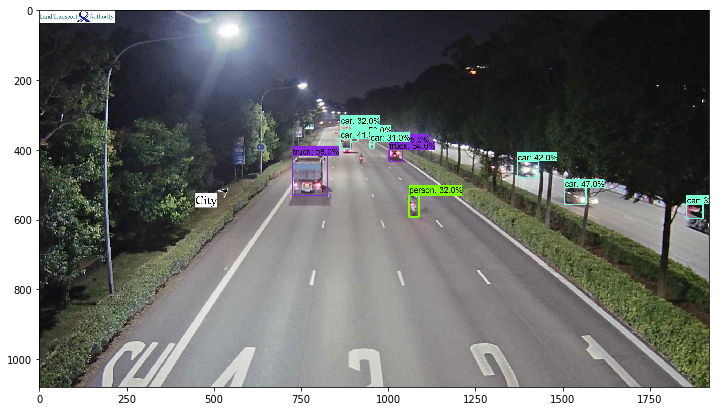

3.0239484310150146

4709_2110_20200808211230_393126.jpg


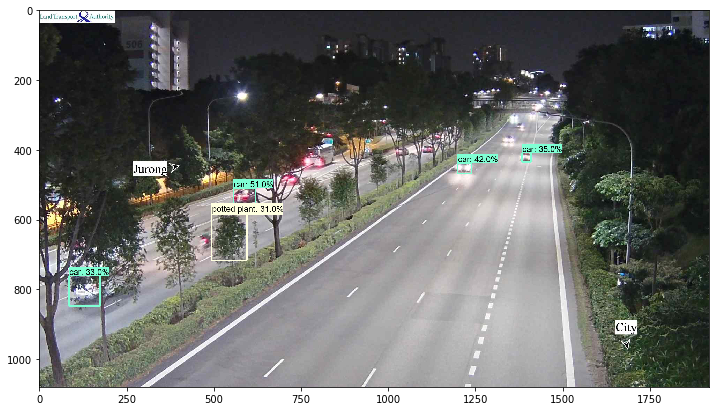

3.0448529720306396

4710_2110_20200808211223_f43c06.jpg


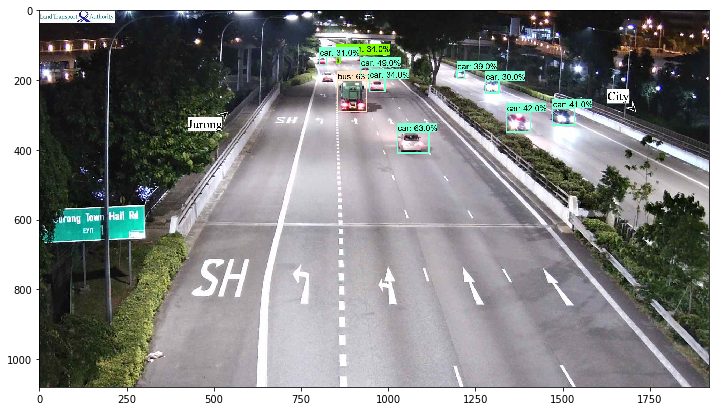

3.078730821609497

4712_2109_20200808211222_088111.jpg


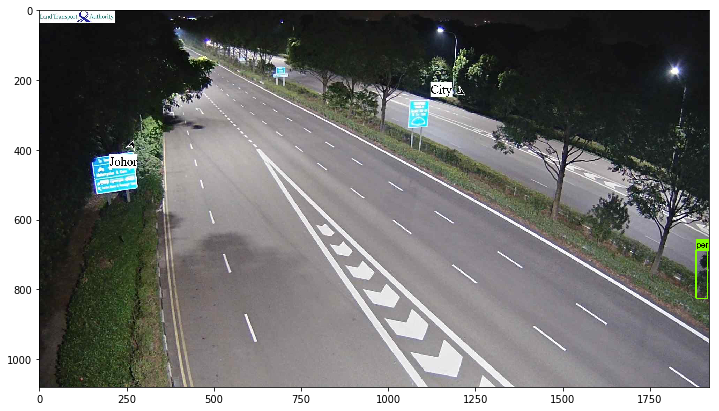

2.910214424133301

4713_2109_20200808211222_24ed07.jpg


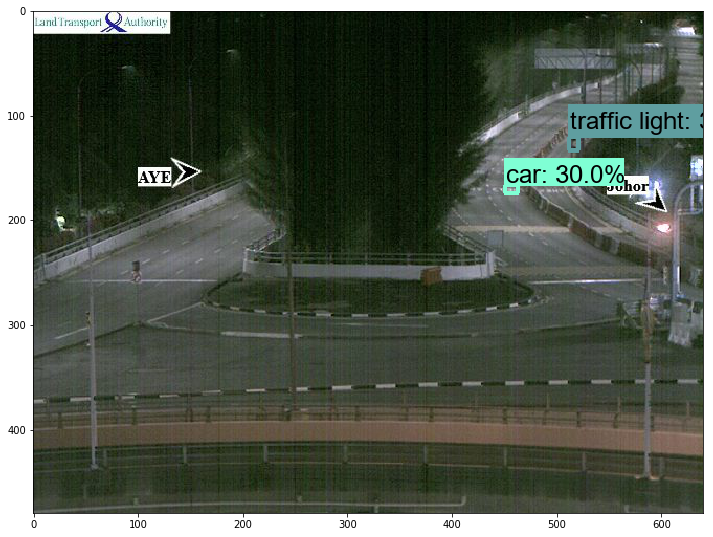

1.6096954345703125

4714_2109_20200808211221_9a1f4d.jpg


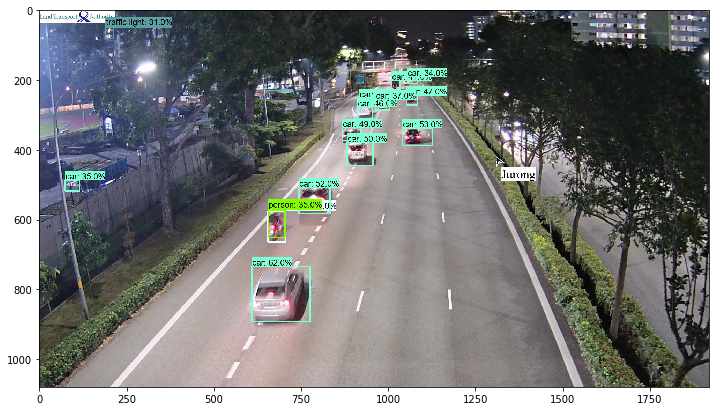

3.2243738174438477

4716_2109_20200808211221_c3460e.jpg


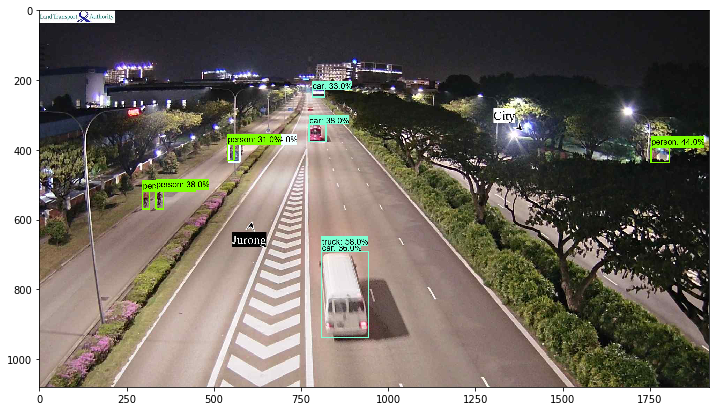

3.0757720470428467

4798_2110_20200808211211_233fae.jpg


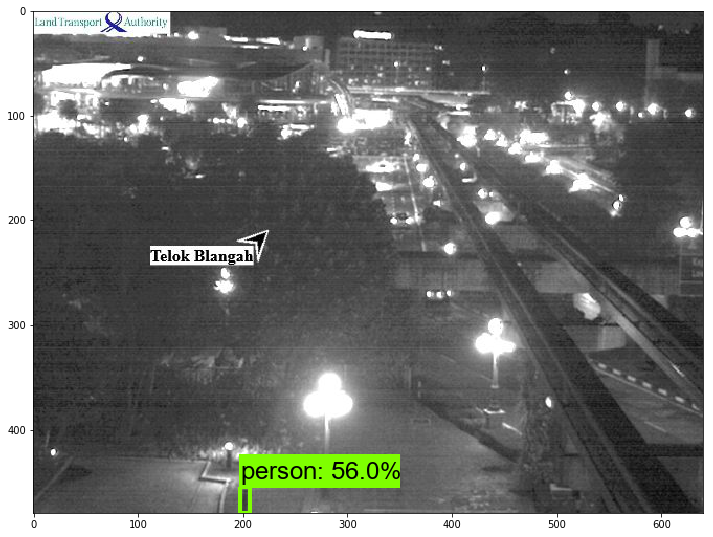

1.5338988304138184

4799_2110_20200808211211_193cd7.jpg


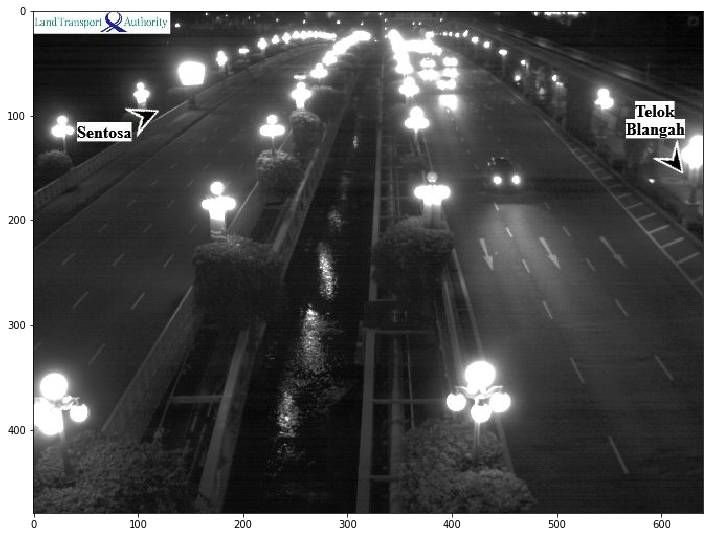

1.8540406227111816

5794_2110_20200808211215_262e5e.jpg


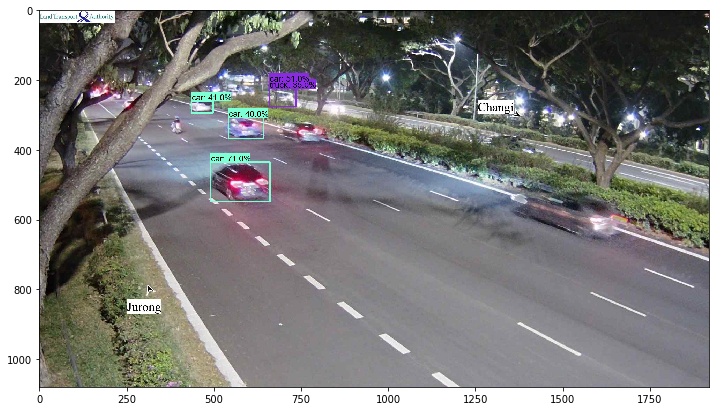

3.214399576187134

5795_2110_20200808211214_305b04.jpg


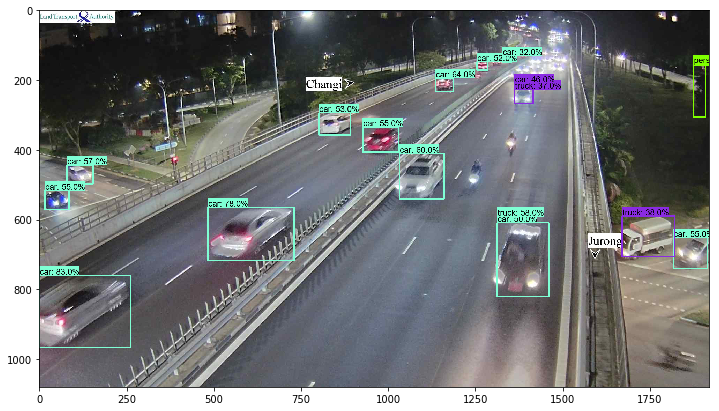

3.2623097896575928

5797_2110_20200808211214_bb3af8.jpg


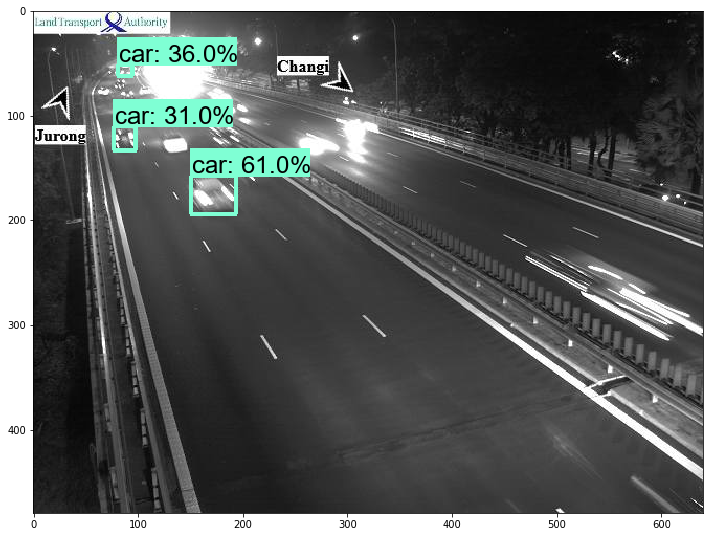

1.5228891372680664

5798_2109_20200808211213_7e143d.jpg


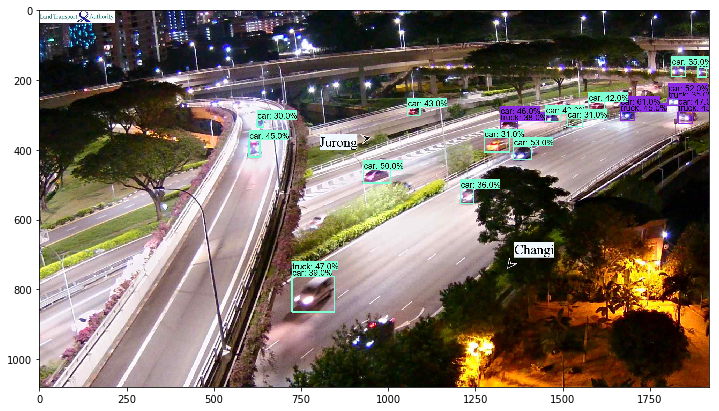

3.4198527336120605

5799_2108_20200808211212_90edf5.jpg


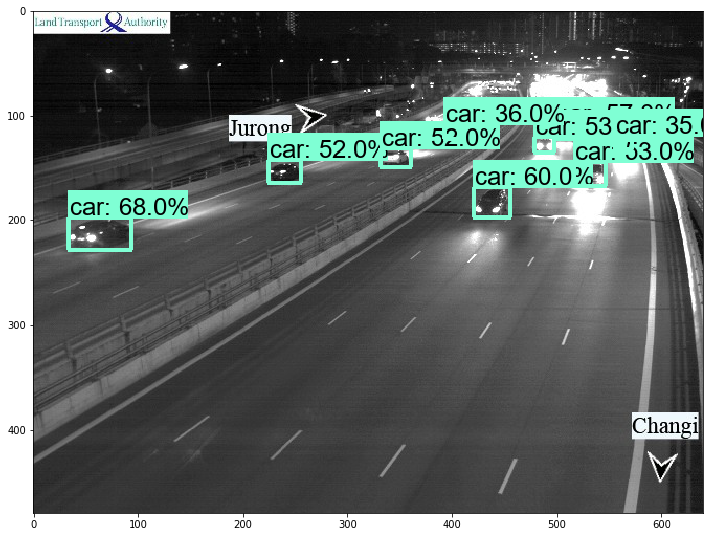

1.5797736644744873

6701_2110_20200808211236_ad0004.jpg


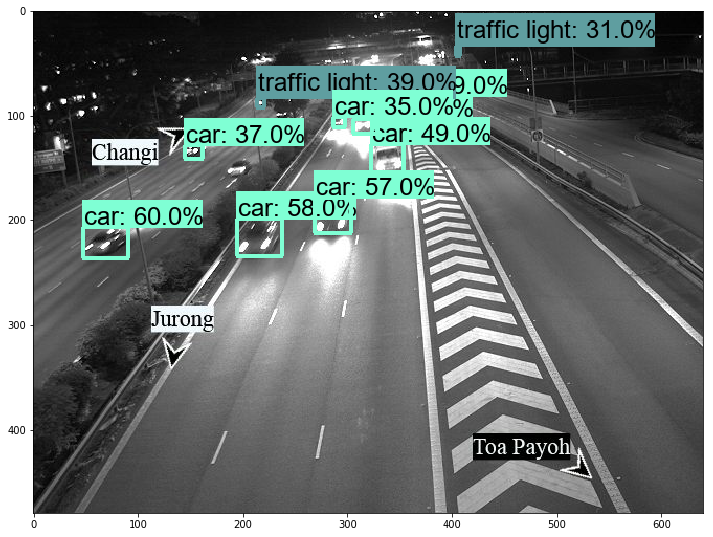

1.5768177509307861

6703_2109_20200808211236_4b9118.jpg


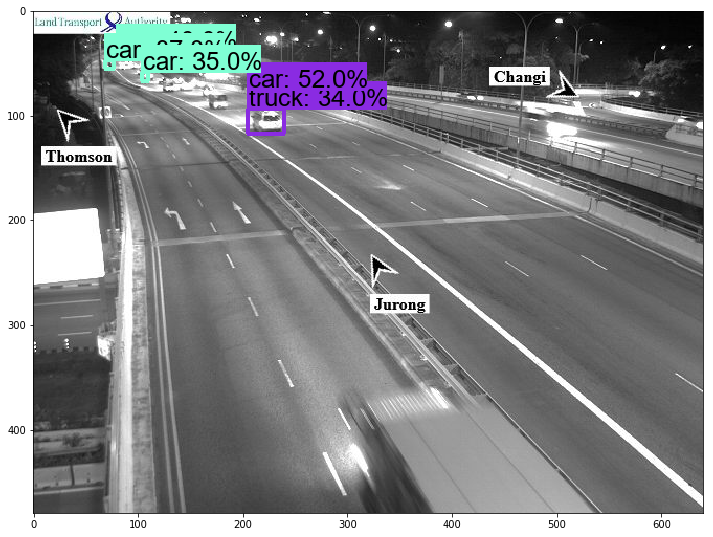

1.4780118465423584

6704_2110_20200808211236_00704c.jpg


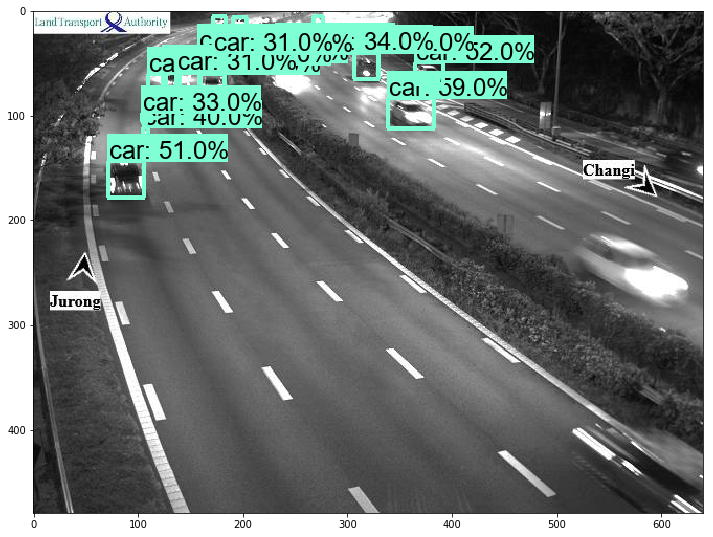

1.6386570930480957

6705_2110_20200808211236_05a3d9.jpg


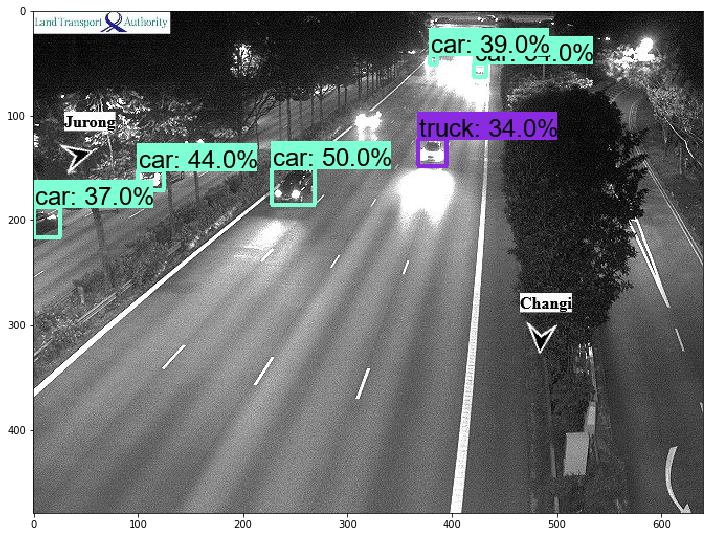

1.5408368110656738

6706_2109_20200808211235_01416b.jpg


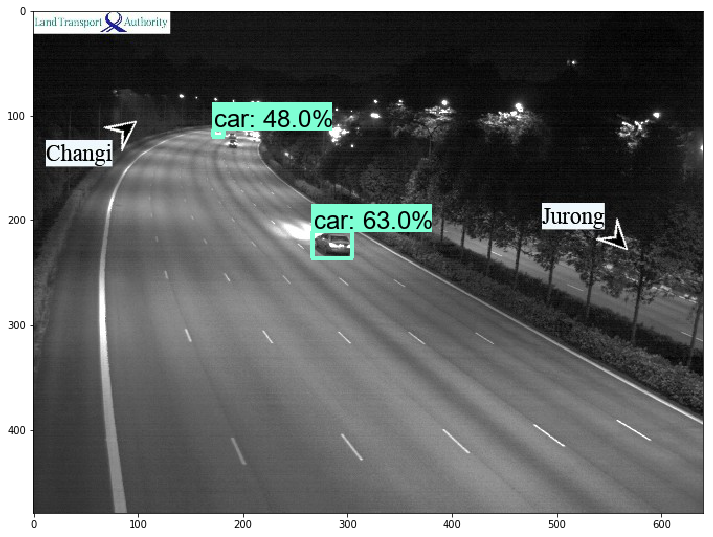

1.473059892654419

6708_2110_20200808211235_bac4cd.jpg


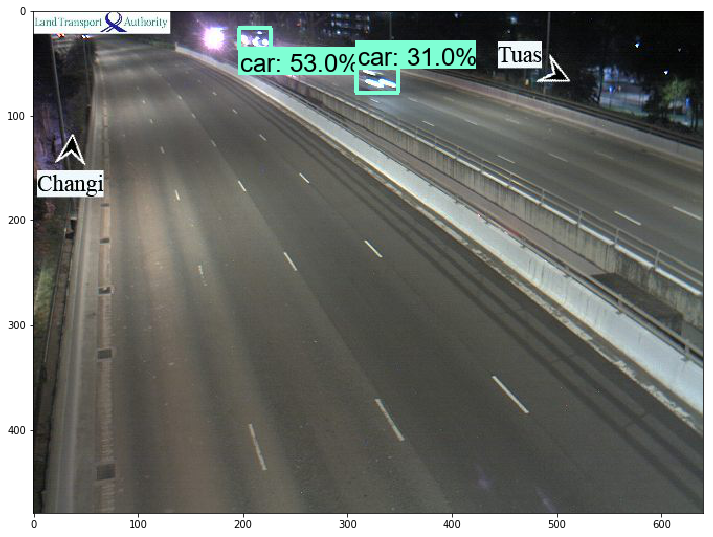

1.5478596687316895

6710_2110_20200808211226_0673f5.jpg


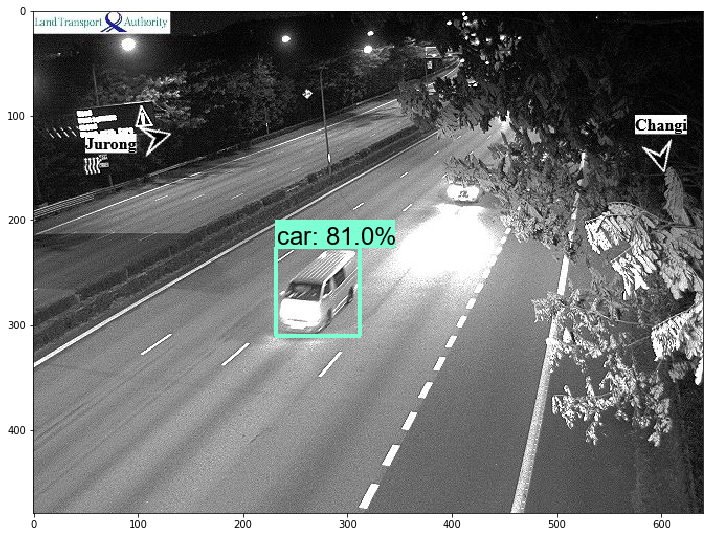

1.600719690322876

6711_2109_20200808211225_d0c862.jpg


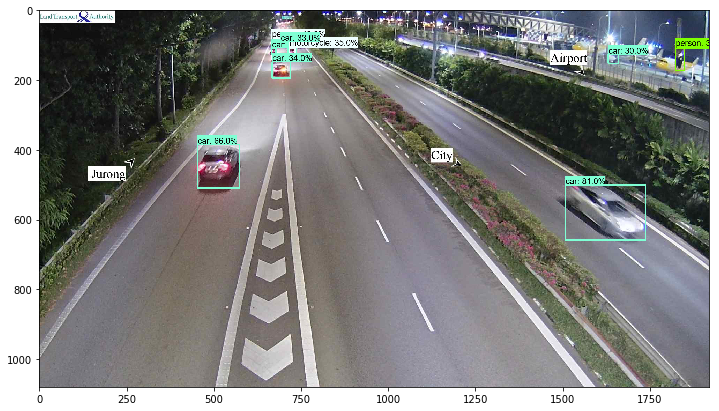

3.136643648147583

6712_2109_20200808211224_4504b0.jpg


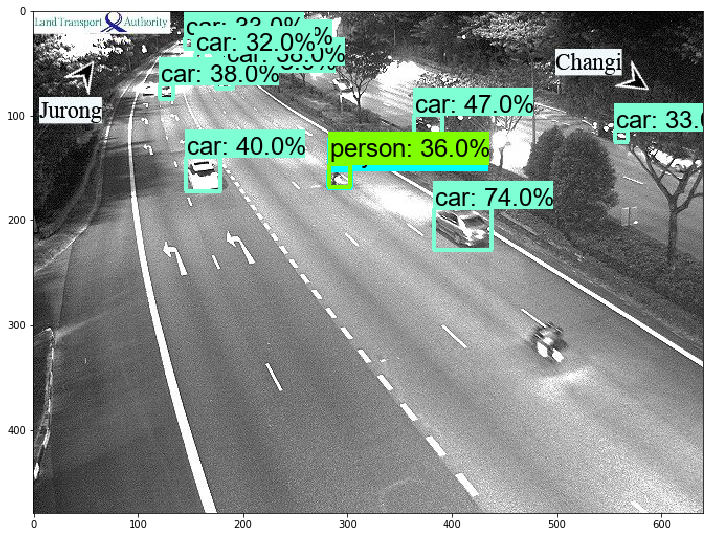

1.5328638553619385

6713_2109_20200808211224_fa9c4c.jpg


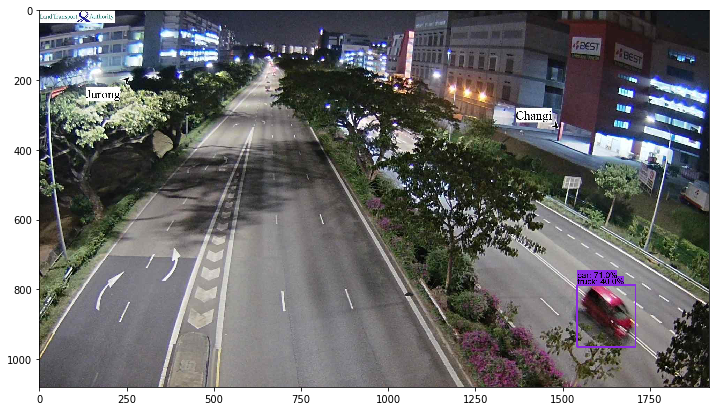

2.870356798171997

6714_2110_20200808211223_b6ed5d.jpg


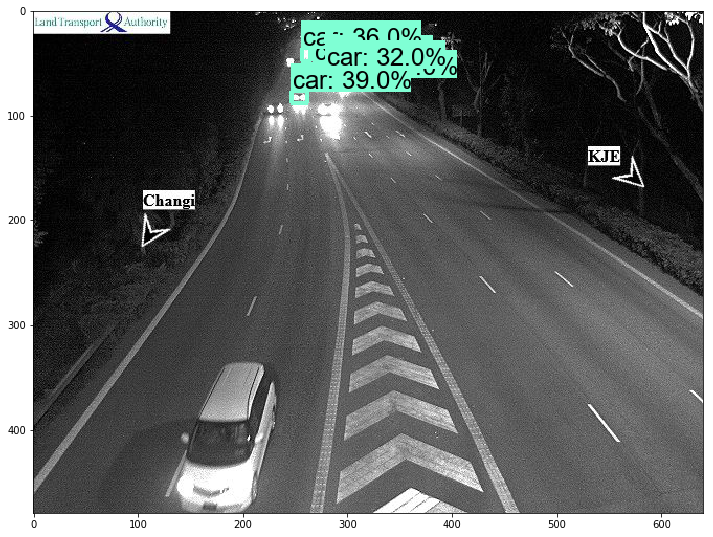

1.5228915214538574

6715_2110_20200808211223_531896.jpg


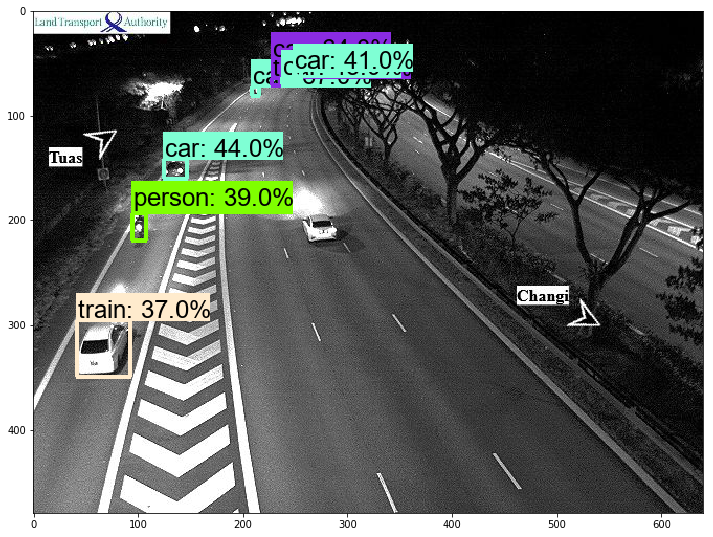

1.5289103984832764

6716_2109_20200808211223_18d4d7.jpg


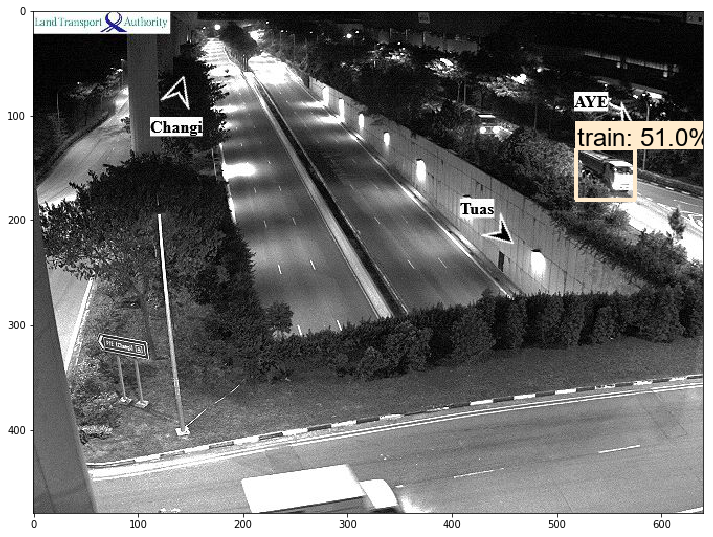

1.481074571609497

7791_2109_20200808211220_0249cc.jpg


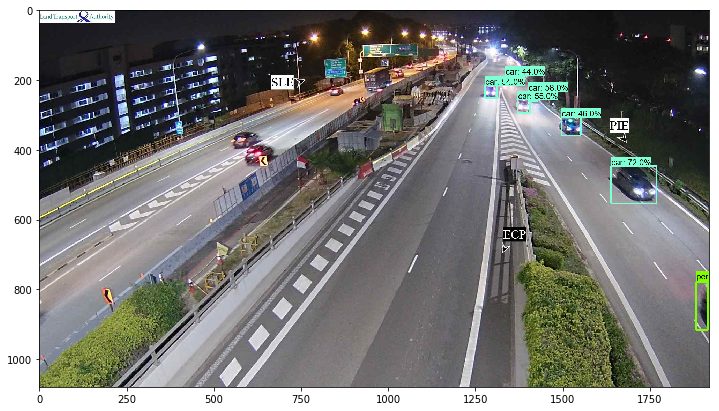

2.947080373764038

7793_2109_20200808211220_31bef2.jpg


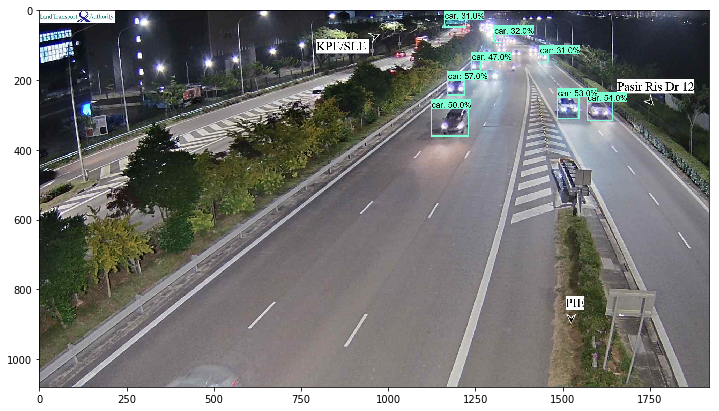

2.9810261726379395

7794_2110_20200808211219_23c8b3.jpg


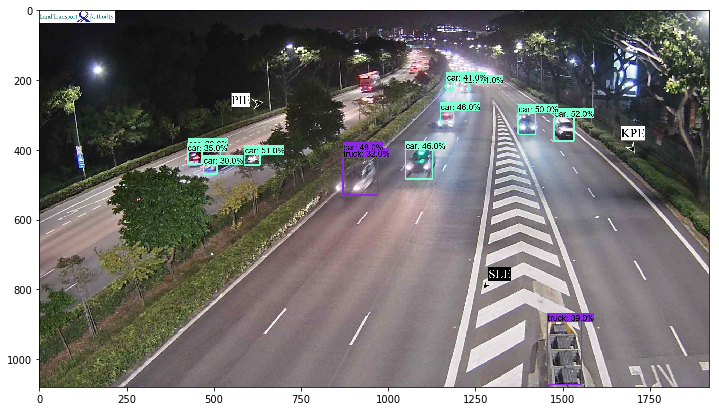

3.1256744861602783

7795_2109_20200808211219_5d275f.jpg


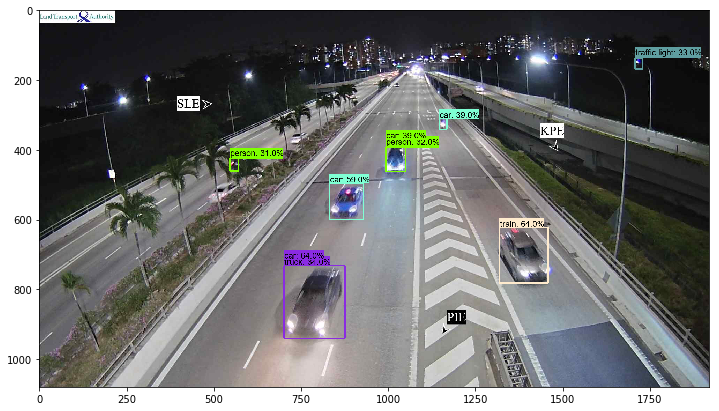

3.542489767074585

7796_2109_20200808211218_da7822.jpg


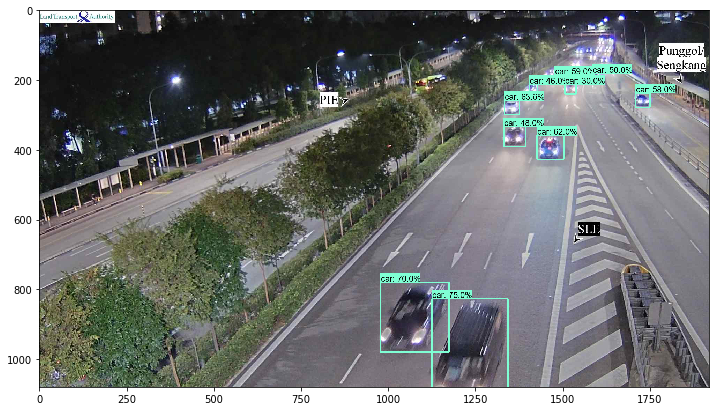

3.057854175567627

7797_2110_20200808211217_e2fc0c.jpg


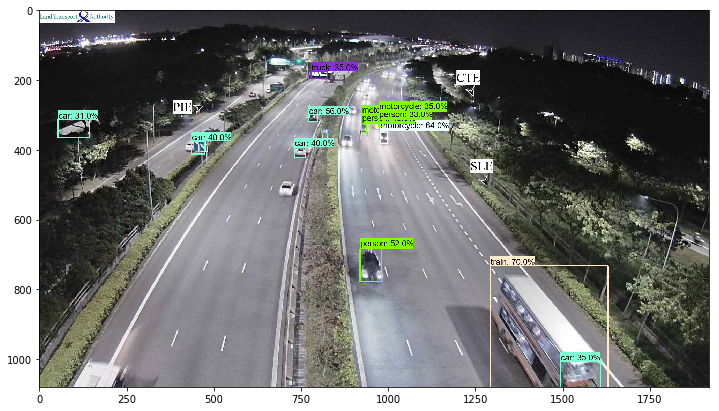

3.0537962913513184

7798_2110_20200808211216_9e3453.jpg


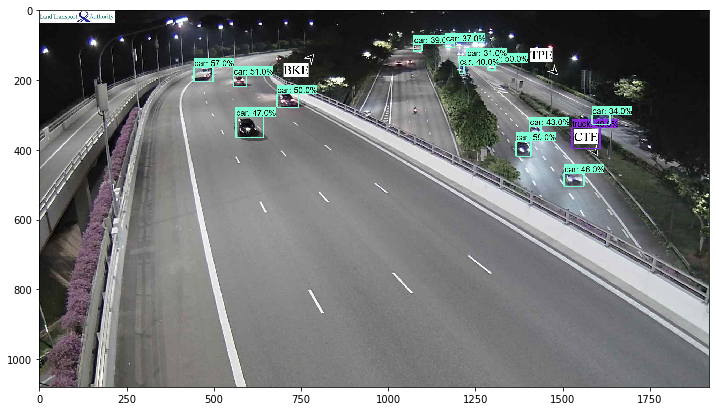

3.0718159675598145

8701_2109_20200808211238_4a361d.jpg


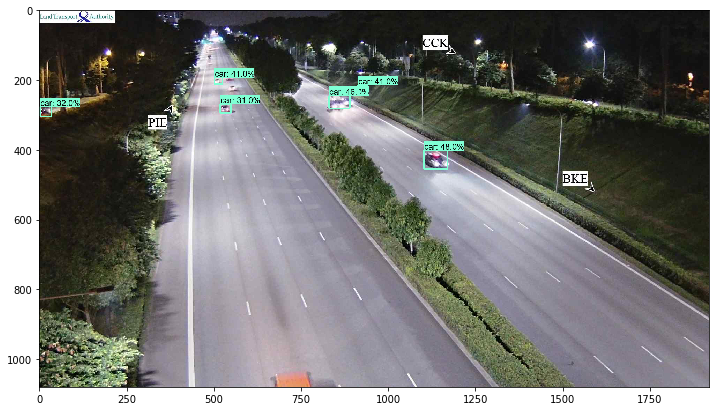

2.944092035293579

8702_2109_20200808211237_c4563d.jpg


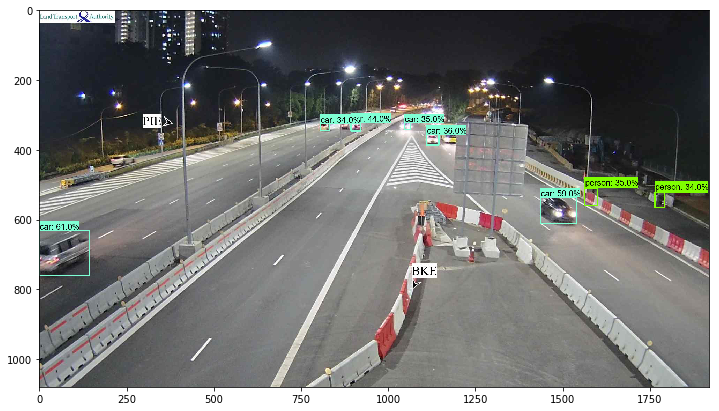

2.9591219425201416

8704_2109_20200808211237_3dc1bb.jpg


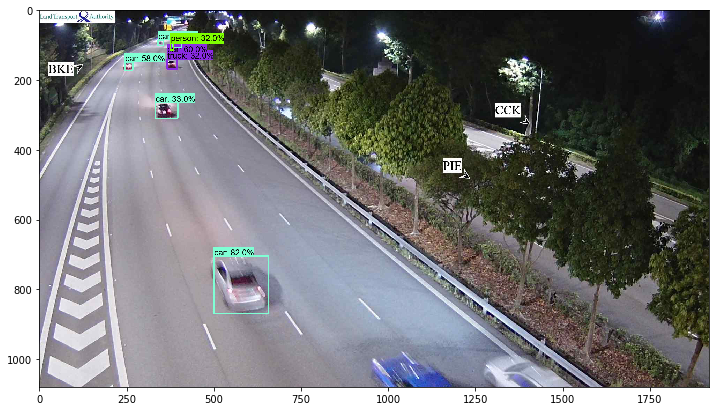

3.023874044418335

8706_2109_20200808211236_9bd929.jpg


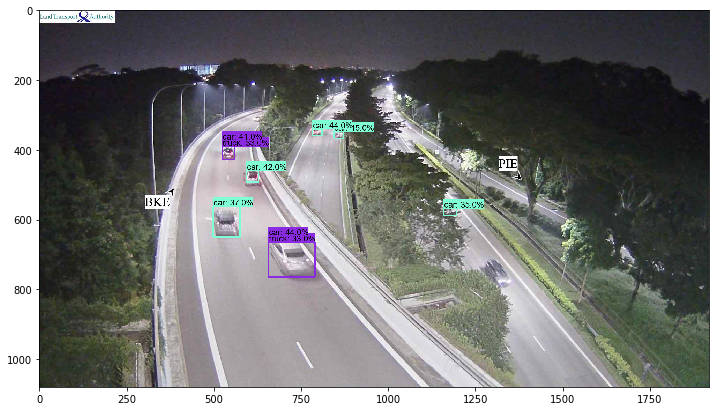

3.388936996459961

9701_2110_20200808211239_f4ce48.jpg


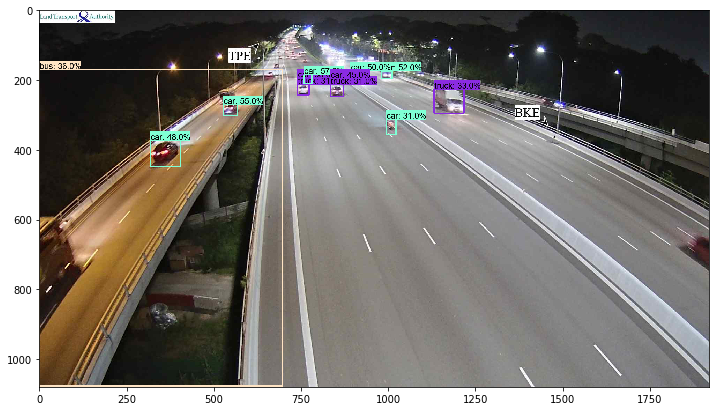

3.016967535018921

9702_2109_20200808211239_8b2d0c.jpg


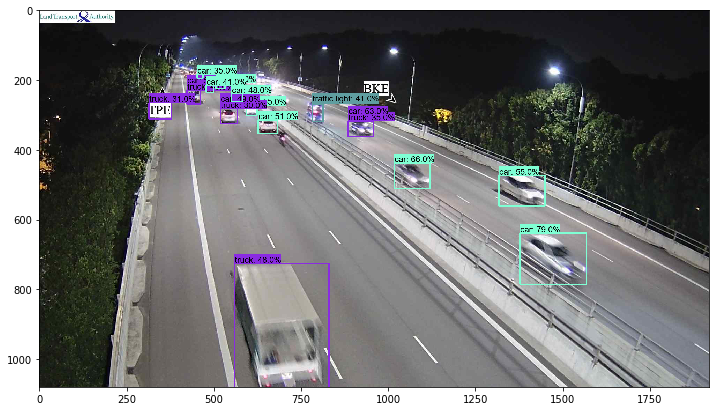

3.1096420288085938

9703_2109_20200808211239_9ea514.jpg


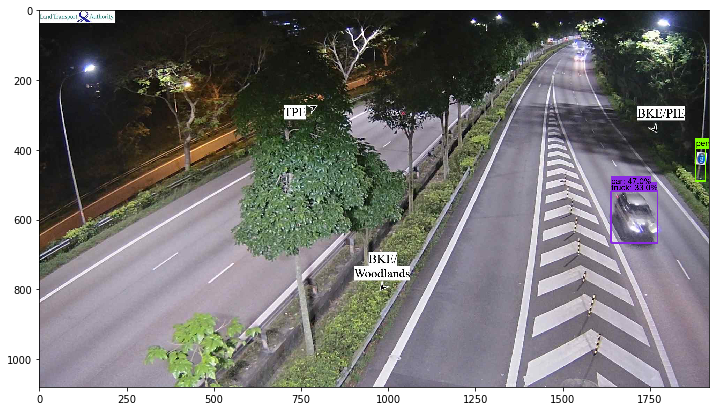

3.4527645111083984

9704_2109_20200808211238_7fc3a8.jpg


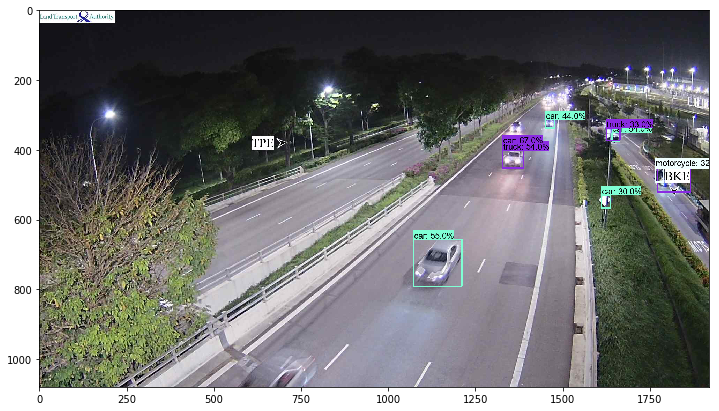

2.989004135131836

9705_2109_20200808211238_305d86.jpg


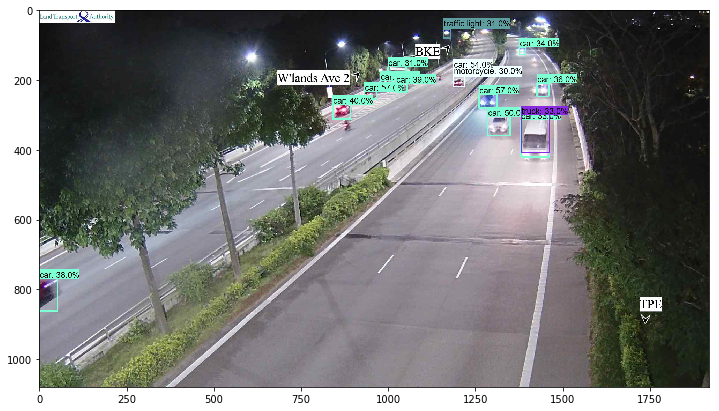

3.1645703315734863

9706_2110_20200808211237_6c76b5.jpg


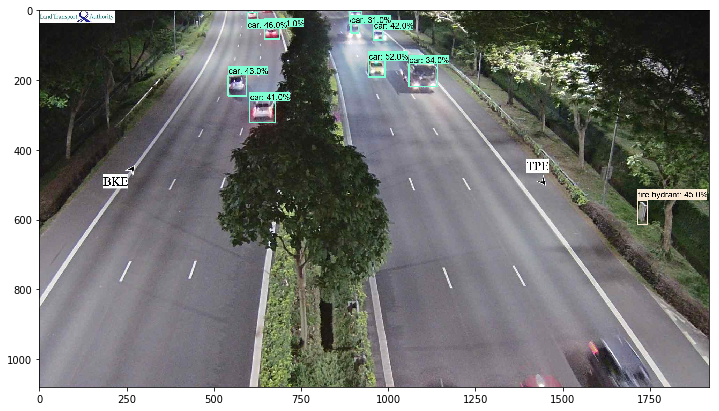

3.006956100463867

Complete. Total time: 226.36


In [17]:
s0 = time()
images = [x for x in os.listdir(data_dir) if x.endswith('.jpg')]
compiled = []


print('%s images to process'%len(images))
for image_file in images:
    s = time()
    print(image_file)
    image_path = os.path.join(data_dir, image_file)
    image_np = load_image_into_numpy_array(image_path)

    input_tensor = tf.convert_to_tensor(np.expand_dims(image_np, 0), dtype=tf.float32)
    detections, predictions_dict, shapes = detect_fn(input_tensor)

    label_id_offset = 1
    
    image_np_with_detections = image_np.copy()
    # Use keypoints if available in detections
    keypoints, keypoint_scores = None, None
    if 'detection_keypoints' in detections:
        keypoints = detections['detection_keypoints'][0].numpy()
        keypoint_scores = detections['detection_keypoint_scores'][0].numpy()

    viz_utils.visualize_boxes_and_labels_on_image_array(
          image_np_with_detections,
          detections['detection_boxes'][0].numpy(),
          (detections['detection_classes'][0].numpy() + label_id_offset).astype(int),
          detections['detection_scores'][0].numpy(),
          category_index,
          use_normalized_coordinates=True,
          max_boxes_to_draw=200,
          min_score_thresh=.30,
          agnostic_mode=False,
          keypoints=keypoints,
          keypoint_scores=keypoint_scores,
          keypoint_edges=get_keypoint_tuples(configs['eval_config']))

    plt.figure(figsize=(12,16))
    plt.imshow(image_np_with_detections)
    plt.show()
    print(time()-s)
    print()

print('Complete. Total time: %.2f'%(time()-s0))